### BUSINESS CASE 2: To Explore Football Skills and Cluster Football players based on their Attributes

### Model Creation

#### PRINICIPLE COMPONENT ANALYSIS

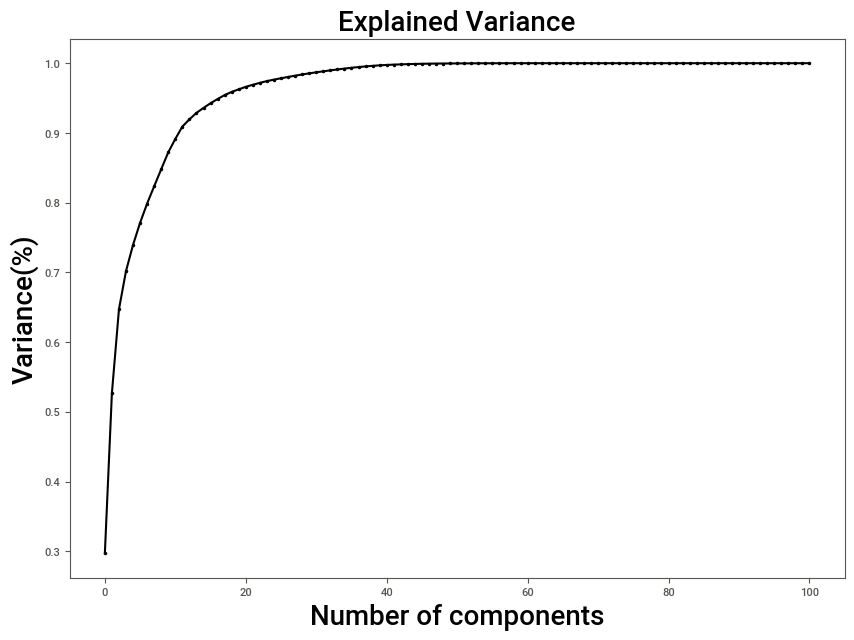

In [94]:
# Getting the optimal number of PCA

from sklearn.decomposition import PCA

pca = PCA() # Object creation
principlecomponents = pca.fit_transform(fifa_processed_df) # Fitting the data
plt.figure(figsize = (10, 7))
plt.plot(np.cumsum(pca.explained_variance_ratio_), marker = '.', color = 'k') # Plot the variance ratio
plt.xlabel('Number of components', fontsize = 20)
plt.ylabel('Variance(%)', fontsize = 20) 
plt.title('Explained Variance',fontsize = 20)

plt.show()

In [95]:
# Calculate the cumulative explained variance ratio
cumulative_explained_variance = np.cumsum(pca.explained_variance_ratio_)

# Find the number of components that add up to 95% of the explained variance ratio
n_components = np.argmax(cumulative_explained_variance >= 0.95) + 1

# Print the number of components
print("Number of components that add up to 95% of the explained variance ratio:", n_components)

Number of components that add up to 95% of the explained variance ratio: 18


In [96]:
pca = PCA(n_components = n_components)

pca_data = pca.fit_transform(comp_fifa)

In [97]:
# Create the new DataFrame by adding PCA columns to the original dataframe

pca_df = pd.DataFrame(pca_data, columns = ["PC{}".format(i+1) for i in range(n_components)])

In [98]:
pca_df

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18
0,9.301728e+07,250439.930710,11.662568,231.735770,291.852676,246.424017,-8.443920,182.721280,-71.863741,-0.427198,-28.678904,3.434067,15.067476,7.158324,34.520970,-21.030879,9.884146,9.810480
1,5.601696e+07,211803.883781,153.765688,291.114318,141.135511,118.643884,86.467318,104.846362,-10.216160,-22.073239,17.388476,5.942292,12.828292,2.398275,9.623652,-18.147319,13.712043,1.052795
2,1.030163e+08,-57359.537936,68.559004,70.153409,286.505052,257.435670,-31.901502,145.102387,-57.302081,14.891376,-47.213893,-8.021340,16.985634,1.889663,26.115353,-21.521767,2.120579,-12.048636
3,7.501594e+07,-130516.143448,-371.270338,45.270915,401.252515,105.971325,57.455043,47.460941,-23.358804,-13.501228,-16.669405,-26.424685,16.257791,43.239317,17.037292,11.705355,-5.008064,26.504279
4,8.751700e+07,173480.743982,209.709102,0.541964,260.470981,243.166040,-12.556275,184.994269,-66.940489,-4.678668,-19.258862,13.806707,12.542824,6.353250,37.332821,-13.301774,8.313903,-9.358438
5,8.751667e+07,73481.306786,-15.090864,-280.728048,211.376969,200.683833,-26.687480,134.758815,-34.648258,9.956890,-32.024892,7.462221,17.442495,-1.285372,47.324995,-23.509669,-2.823752,1.046378
6,6.501640e+07,27283.939631,-148.294659,-36.782610,375.990790,101.556823,-0.570412,87.521288,-18.631530,3.219543,-10.155973,-18.128622,11.580537,50.844906,15.221526,17.498562,-1.077239,28.568438
7,7.551618e+07,-57156.729500,-66.775181,-219.041301,246.294741,163.445216,46.471078,-23.168458,-4.612846,9.439794,-20.146865,-12.016655,20.900652,-10.742068,11.785544,-15.635851,-3.461037,18.007776
8,4.251682e+07,191085.245207,186.578134,-199.966961,46.712628,60.385664,-6.965609,79.361172,-57.272785,-1.873476,-14.242724,-4.450529,1.552293,-2.582443,17.041331,-0.949738,19.320904,-2.867169
9,7.801630e+07,-25357.065262,75.011086,295.923537,213.559833,156.996744,-15.192902,53.324676,-45.319024,7.887861,-23.360234,-3.543003,8.547558,-3.524181,30.773084,-16.298069,-4.329085,2.646445


In [99]:
X = pca_df
X.shape

(18278, 18)

#### K-MEANS ALGORITHM

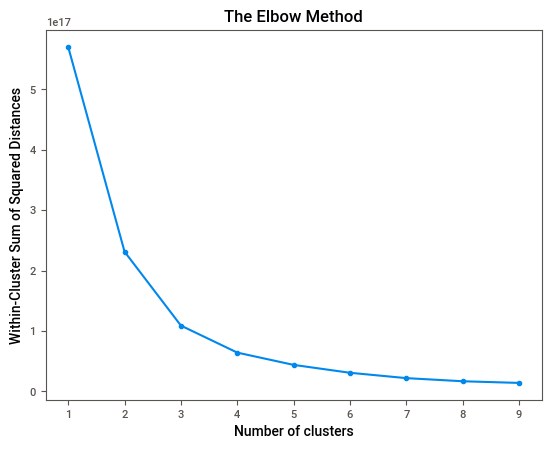

In [100]:
from sklearn.cluster import KMeans
wcss = []
for i in range (1, 10):
    kmeans = KMeans(n_clusters = i, random_state = 42)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)
plt.plot(range(1, 10), wcss, marker = 'o')
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('Within-Cluster Sum of Squared Distances')

plt.show()

In [101]:
centroids = kmeans.cluster_centers_
centroids

array([[-1.92383494e+06, -9.73975950e+01,  1.33533418e-01,
        -1.28558323e+00,  9.42401396e+00,  6.38810475e+00,
         9.52406519e-01,  3.28048418e+00, -1.59349253e+00,
         3.23661735e-01, -9.21843382e-01, -1.03058063e-01,
         2.72245133e-01, -1.30942367e-01,  9.59497405e-01,
        -5.84630375e-01, -3.34320244e-02,  1.16305756e-01],
       [ 2.71827590e+07, -4.95201659e+03, -2.14791549e+01,
         1.59821953e+01,  2.86115388e+01,  1.47053950e+01,
         7.94861804e+00,  1.27902653e+01, -5.31781961e+00,
        -4.26413869e-01, -3.24076187e+00, -1.44690678e+00,
         1.79399747e+00, -9.18277705e-02,  2.31194856e+00,
        -1.35765247e+00, -4.64226022e-01, -1.98575464e-02],
       [ 8.71213196e+06, -3.00722831e+03,  1.39245924e+01,
        -9.76503140e-01, -3.15682233e+01, -1.98269058e+01,
        -3.35167121e+00, -1.05135062e+01,  5.04669391e+00,
         5.62333361e-01,  2.13927215e+00,  9.69652530e-01,
        -2.24802449e+00, -9.89324114e-01, -3.07025622e

In [102]:
from sklearn.cluster import KMeans

for i in range(2, 6):
    model = KMeans(n_clusters = i, random_state = 42)
    model.fit(X)
    label = model.labels_
    label
    
# Getting Silhouette score

    from sklearn.metrics import silhouette_score
    score = silhouette_score(X, label)
    print('The silhouettee_score for {} clusters in KMeans Algorithm is {}.'.format(i, round(score, 2)))

The silhouettee_score for 2 clusters in KMeans Algorithm is 0.89.
The silhouettee_score for 3 clusters in KMeans Algorithm is 0.82.
The silhouettee_score for 4 clusters in KMeans Algorithm is 0.8.
The silhouettee_score for 5 clusters in KMeans Algorithm is 0.78.


#### We select n_cluster = 2 based on results from elbow method,silhouettee score and Davies bouldin score

In [103]:
final_kmeans_model = KMeans(n_clusters = 2, random_state = 42)
cluster_labels = final_kmeans_model.fit_predict(X)
cluster_labels

array([1, 1, 1, ..., 0, 0, 0])

In [104]:
# Count the number of data points in each cluster
cluster_counts = pd.Series(cluster_labels).value_counts()

# Print the cluster counts
print(cluster_counts)

0    17740
1      538
dtype: int64


##### We have 2 labels 0 and 1

#### Putting the clusters in the Data Set

In [105]:
comp_fifa['Cluster'] = cluster_labels
comp_fifa[comp_fifa['Cluster'] == 1]

,age,height_cm,weight_kg,overall,potential,value_eur,wage_eur,international_reputation,weak_foot,skill_moves,jersey_number,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,movement_acceleration,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_vision,mentality_penalties,mentality_composure,defending_sliding_tackle,goalkeeping_kicking,nationality,club,player_positions,preferred_foot,work_rate,body_type,real_face,team_position,overall,ls_overall,ls_potential,st_overall,st_potential,rs_overall,rs_potential,lw_overall,lw_potential,lf_overall,lf_potential,cf_overall,cf_potential,rf_overall,rf_potential,rw_overall,rw_potential,lam_overall,lam_potential,cam_overall,cam_potential,ram_overall,ram_potential,lm_overall,lm_potential,lcm_overall,lcm_potential,cm_overall,cm_potential,rcm_overall,rcm_potential,rm_overall,rm_potential,lwb_overall,lwb_potential,ldm_overall,ldm_potential,cdm_overall,cdm_potential,rdm_overall,rdm_potential,rwb_overall,rwb_potential,lb_overall,lb_potential,lcb_overall,lcb_potential,cb_overall,cb_potential,rcb_overall,rcb_potential,rb_overall,rb_potential,Cluster
0,32,170,72,94,94,95500000,565000,5,4,4,10.0,87.0,92.0,92.0,96.0,39.0,66.0,88,95,70,88,97,93,94,92,91,93,95,95,86,68,75,68,94,48,94,75,96,26,15,5,224,544,0,7,1,1,25,94,89.0,91.0,89.0,91.0,89.0,91.0,93.0,95.0,93.0,95.0,93.0,95.0,93.0,95.0,93.0,95.0,93.0,95.0,93.0,95.0,93.0,95.0,92.0,94.0,87.0,89.0,87.0,89.0,87.0,89.0,92.0,94.0,68.0,70.0,66.0,68.0,66.0,68.0,66.0,68.0,68.0,70.0,63.0,65.0,52.0,54.0,52.0,54.0,52.0,54.0,63.0,65.0,1
1,34,187,83,93,93,58500000,405000,5,4,5,7.0,90.0,93.0,82.0,89.0,35.0,78.0,84,94,89,87,89,81,76,77,89,87,96,71,95,95,85,78,93,63,82,85,95,24,15,121,350,620,1,1,1,1,14,93,91.0,94.0,91.0,94.0,91.0,94.0,89.0,92.0,90.0,93.0,90.0,93.0,90.0,93.0,89.0,92.0,88.0,91.0,88.0,91.0,88.0,91.0,88.0,91.0,81.0,84.0,81.0,84.0,81.0,84.0,88.0,91.0,65.0,68.0,61.0,64.0,61.0,64.0,61.0,64.0,65.0,68.0,61.0,64.0,53.0,56.0,53.0,56.0,53.0,56.0,61.0,64.0,1
2,27,175,68,92,92,105500000,290000,5,5,5,10.0,91.0,85.0,87.0,95.0,32.0,58.0,87,87,62,87,96,88,87,81,94,96,92,84,80,61,81,49,84,51,90,90,94,29,15,18,462,344,1,2,1,1,0,92,84.0,87.0,84.0,87.0,84.0,87.0,90.0,93.0,89.0,92.0,89.0,92.0,89.0,92.0,90.0,93.0,90.0,93.0,90.0,93.0,90.0,93.0,89.0,92.0,82.0,85.0,82.0,85.0,82.0,85.0,89.0,92.0,66.0,69.0,61.0,64.0,61.0,64.0,61.0,64.0,66.0,69.0,61.0,64.0,46.0,49.0,46.0,49.0,46.0,49.0,61.0,64.0,1
3,26,188,87,91,93,77500000,125000,3,3,1,1.0,52.0,78.0,90.0,87.0,89.0,92.0,13,11,15,13,12,13,14,40,43,67,88,49,59,78,41,78,12,34,65,11,68,18,78,133,63,226,1,8,1,1,5,91,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,66.0,71.0,1
4,28,175,74,91,91,90000000,470000,4,4,4,10.0,91.0,83.0,86.0,94.0,35.0,66.0,81,84,61,83,95,83,79,83,94,95,90,94,82,56,84,63,80,54,89,88,91,22,6,12,505,350,1,2,1,1,14,91,83.0,86.0,83.0,86.0,83.0,86.0,89.0,92.0,88.0,91.0,88.0,91.0,88.0,91.0,89.0,92.0,89.0,92.0,89.0,92.0,89.0,92.0,89.0,92.0,83.0,86.0,83.0,86.0,83.0,86.0,89.0,92.0,66.0,69.0,63.0,66.0,63.0,66.0,63.0,66.0,66.0,69.0,61.0,64.0,49.0,52.0,49.0,52.0,49.0,52.0,61.0,64.0,1
5,28,181,70,91,91,90000000,370000,4,5,4,7.0,76.0,86.0,92.0,86.0,61.0,78.0,93,82,55,82,86,85,83,91,77,78,91,76,91,63,89,74,90,76,94,79,91,51,5,12,400,11,1,0,1,1,19,91,82.0,85.0,82.0,85.0,82.0,85.0,87.0,90.0,87.0,90.0,87.0,90.0,87.0,90.0,87.0,90.0,88.0,91.0,88.0,91.0,88.0,91.0,88.0,91.0,87.0,90.0,87.0,90.0,87.0,90.0,88.0,91.0,77.0,80.0,77.0,80.0,77.0,80.0,77.0,80.0,77.0,80.0,73.0,76.0,66.0,69.0,66.0,69.0,66.0,69.0,73.0,76.0,1
6,27,187,85,90,93,67500000,250000,3,4,1,22.0,45.0,88.0,88.0,88.0,90.

##### Visualizing the Cluster with players having Higher Attacking Head Accuracy

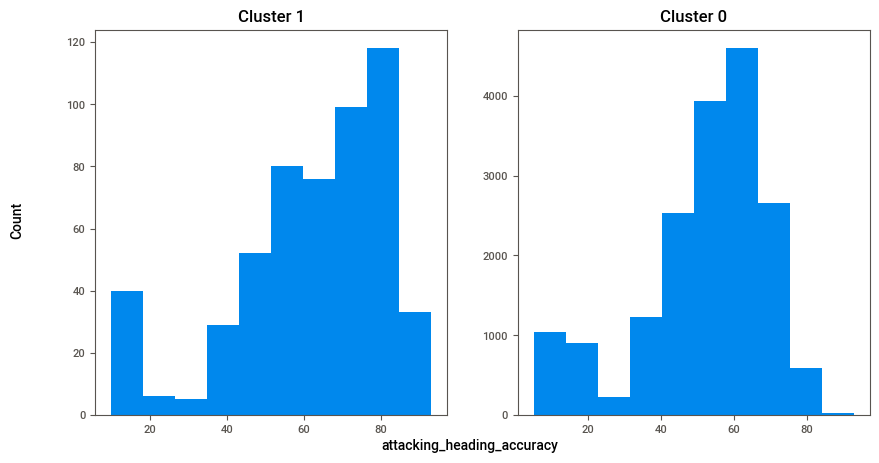

In [106]:
# Create a figure with two subplots
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

# Plot the first histogram in the first subplot
axs[0].hist(comp_fifa[comp_fifa['Cluster']==1]['attacking_heading_accuracy'])
axs[0].set_title('Cluster 1')

# Plot the second histogram in the second subplot
axs[1].hist(comp_fifa[comp_fifa['Cluster']==0]['attacking_heading_accuracy'])
axs[1].set_title('Cluster 0')

# Add a common x-axis label and y-axis label
fig.text(0.5, 0.04, 'attacking_heading_accuracy', ha='center')
fig.text(0.04, 0.5, 'Count', va='center', rotation='vertical')

# Show the plot
plt.show()

##### Visualizing the Cluster with players having Higher Defense

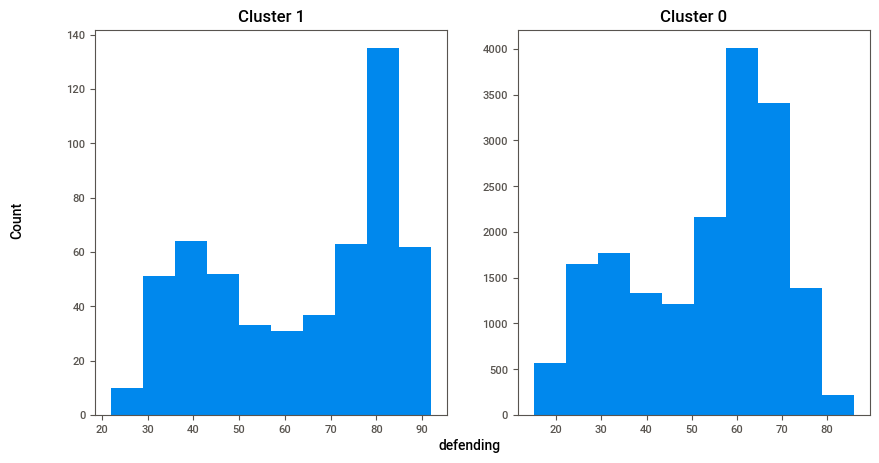

In [107]:
# Create a figure with two subplots
fig, axs = plt.subplots(1, 2, figsize = (10, 5))

# Plot the first histogram in the first subplot
axs[0].hist(comp_fifa[comp_fifa['Cluster'] == 1]['defending'])
axs[0].set_title('Cluster 1')

# Plot the second histogram in the second subplot
axs[1].hist(comp_fifa[comp_fifa['Cluster'] == 0]['defending'])
axs[1].set_title('Cluster 0')

# Add a common x-axis label and y-axis label
fig.text(0.5, 0.04, 'defending', ha = 'center')
fig.text(0.04, 0.5, 'Count', va = 'center', rotation = 'vertical')

# Show the plot
plt.show()

##### Visualizing the Cluster with players having Higher Pace

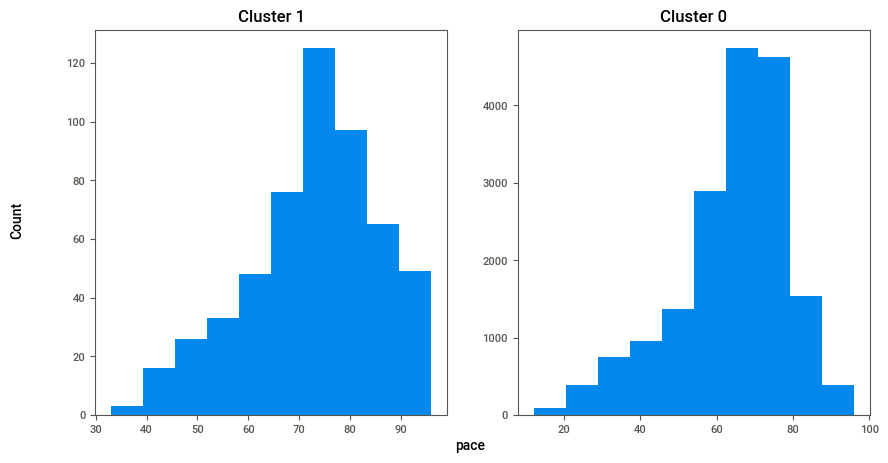

In [108]:
# Create a figure with two subplots
fig, axs = plt.subplots(1, 2, figsize = (10, 5))

# Plot the first histogram in the first subplot
axs[0].hist(comp_fifa[comp_fifa['Cluster'] == 1]['pace'])
axs[0].set_title('Cluster 1')

# Plot the second histogram in the second subplot
axs[1].hist(comp_fifa[comp_fifa['Cluster'] == 0]['pace'])
axs[1].set_title('Cluster 0')

# Add a common x-axis label and y-axis label
fig.text(0.5, 0.04, 'pace', ha = 'center')
fig.text(0.04, 0.5, 'Count', va = 'center', rotation = 'vertical')

# Show the plot
plt.show()

##### Visualizing the Cluster with players having Higher Shooting

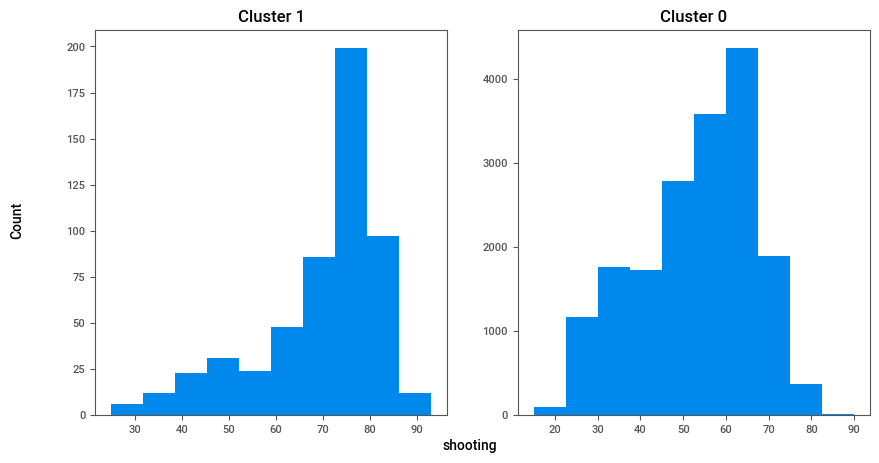

In [109]:
# Create a figure with two subplots
fig, axs = plt.subplots(1, 2, figsize = (10, 5))

# Plot the first histogram in the first subplot
axs[0].hist(comp_fifa[comp_fifa['Cluster'] == 1]['shooting'])
axs[0].set_title('Cluster 1')

# Plot the second histogram in the second subplot
axs[1].hist(comp_fifa[comp_fifa['Cluster'] == 0]['shooting'])
axs[1].set_title('Cluster 0')

# Add a common x-axis label and y-axis label
fig.text(0.5, 0.04, 'shooting', ha = 'center')
fig.text(0.04, 0.5, 'Count', va = 'center', rotation = 'vertical')

# Show the plot
plt.show()

##### Visualizing the Cluster with players having Higher Passing

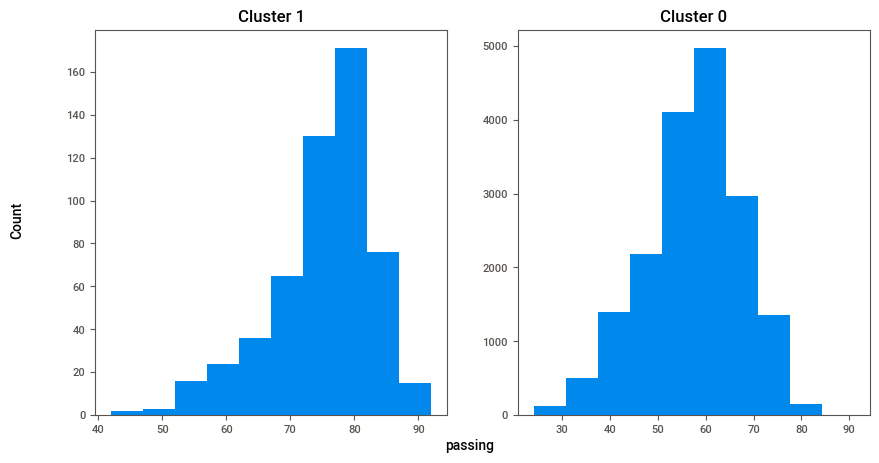

In [110]:
# Create a figure with two subplots
fig, axs = plt.subplots(1, 2, figsize = (10, 5))

# Plot the first histogram in the first subplot
axs[0].hist(comp_fifa[comp_fifa['Cluster'] == 1]['passing'])
axs[0].set_title('Cluster 1')

# Plot the second histogram in the second subplot
axs[1].hist(comp_fifa[comp_fifa['Cluster'] == 0]['passing'])
axs[1].set_title('Cluster 0')

# Add a common x-axis label and y-axis label
fig.text(0.5, 0.04, 'passing', ha = 'center')
fig.text(0.04, 0.5, 'Count', va = 'center', rotation = 'vertical')

# Show the plot
plt.show()

##### Visualizing the Cluster with players having Higher Potential

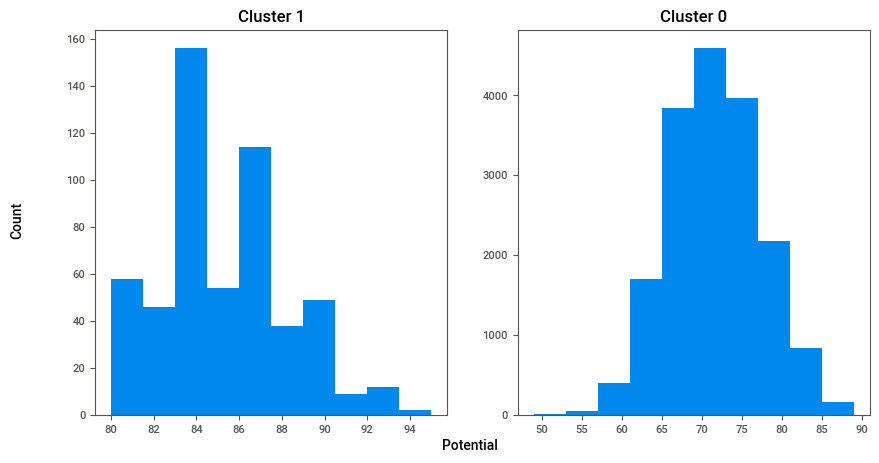

In [111]:
# Create a figure with two subplots
fig, axs = plt.subplots(1, 2, figsize = (10, 5))

# Plot the first histogram in the first subplot
axs[0].hist(comp_fifa[comp_fifa['Cluster'] == 1]['potential'])
axs[0].set_title('Cluster 1')

# Plot the second histogram in the second subplot
axs[1].hist(comp_fifa[comp_fifa['Cluster'] == 0]['potential'])
axs[1].set_title('Cluster 0')

# Add a common x-axis label and y-axis label
fig.text(0.5, 0.04, 'Potential', ha = 'center')
fig.text(0.04, 0.5, 'Count', va = 'center', rotation = 'vertical')

# Show the plot
plt.show()

#### HIERARCHICAL  CLUSTERING ALGORITHM

In [112]:
from sklearn.cluster import AgglomerativeClustering

for i in range(2, 6):
    agg_clustering = AgglomerativeClustering(n_clusters = 2)
    agg_clustering.fit_predict(X)
    
    labels1 = agg_clustering.labels_
    labels1
    
# Getting Silhouette score

    from sklearn.metrics import silhouette_score
    score = silhouette_score(X, label)
    print('The silhouettee_score for {} clusters in Hierarchical Algorithm is {}.'.format(i, round(score, 2)))

The silhouettee_score for 2 clusters in Hierarchical Algorithm is 0.78.
The silhouettee_score for 3 clusters in Hierarchical Algorithm is 0.78.
The silhouettee_score for 4 clusters in Hierarchical Algorithm is 0.78.
The silhouettee_score for 5 clusters in Hierarchical Algorithm is 0.78.


In [113]:
labels1

array([0, 0, 0, ..., 1, 1, 1], dtype=int64)

In [114]:
# Getting the number of data points in each cluster

cluster_counts = pd.Series(labels1).value_counts()

# Printing the cluster counts

print(cluster_counts)

1    17161
0     1117
dtype: int64


In [115]:
comp_fifa = comp_fifa.drop('Cluster', axis = 1)

comp_fifa['Cluster_H'] = labels1

##### Visualizing which cluster of players are having greater potential rating

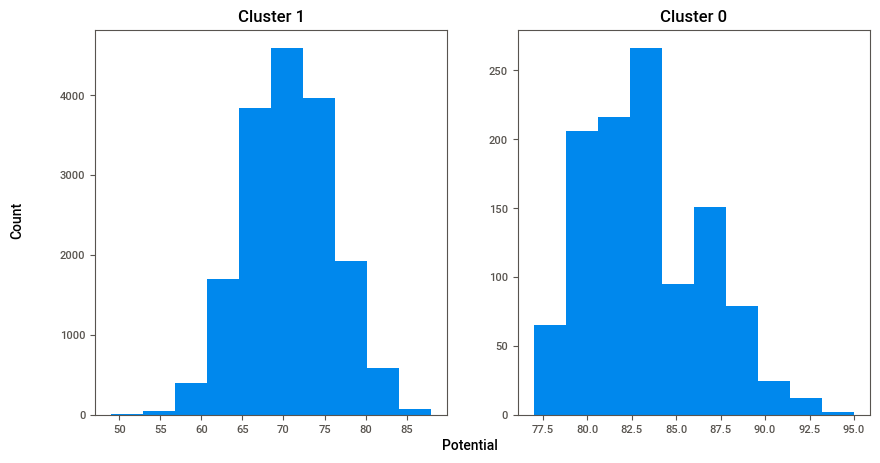

In [116]:
# Create a figure with two subplots
fig, axs = plt.subplots(1, 2, figsize = (10, 5))

# Plot the first histogram in the first subplot
axs[0].hist(comp_fifa[comp_fifa['Cluster_H'] == 1]['potential'])
axs[0].set_title('Cluster 1')

# Plot the second histogram in the second subplot
axs[1].hist(comp_fifa[comp_fifa['Cluster_H'] == 0]['potential'])
axs[1].set_title('Cluster 0')

# Add a common x-axis label and y-axis label
fig.text(0.5, 0.04, 'Potential', ha = 'center')
fig.text(0.04, 0.5, 'Count', va = 'center', rotation = 'vertical')

# Show the plot
plt.show()

##### Visualizing which cluster of players are having greater overall rating

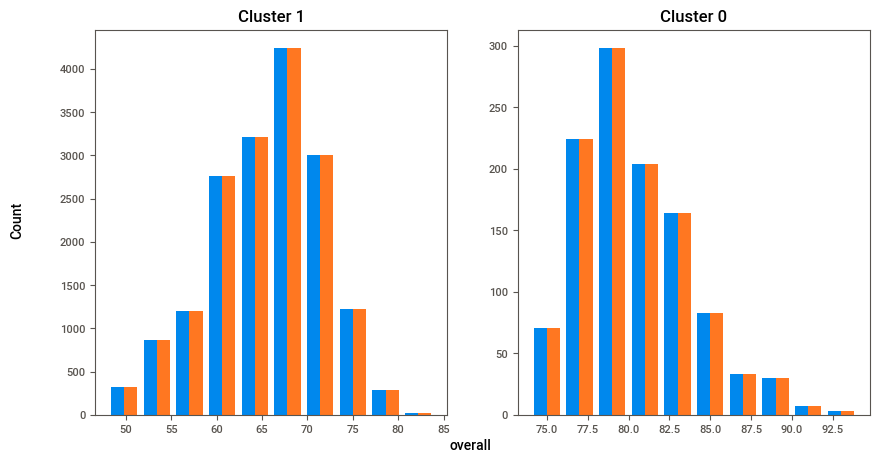

In [117]:
# Create a figure with two subplots
fig, axs = plt.subplots(1, 2, figsize = (10, 5))

# Plot the first histogram in the first subplot
axs[0].hist(comp_fifa[comp_fifa['Cluster_H'] == 1]['overall'])
axs[0].set_title('Cluster 1')

# Plot the second histogram in the second subplot
axs[1].hist(comp_fifa[comp_fifa['Cluster_H'] == 0]['overall'])
axs[1].set_title('Cluster 0')

# Add a common x-axis label and y-axis label
fig.text(0.5, 0.04, 'overall', ha = 'center')
fig.text(0.04, 0.5, 'Count', va = 'center', rotation = 'vertical')

# Show the plot
plt.show()

### BUSINESS CASE 3

### (a) To prepare a rank ordered list of top 10 countries with most players and to find out the countries which are producing most of the footballers that play at that level using FIFA20 Data Set.

##### Top 10 Countries with Most Players

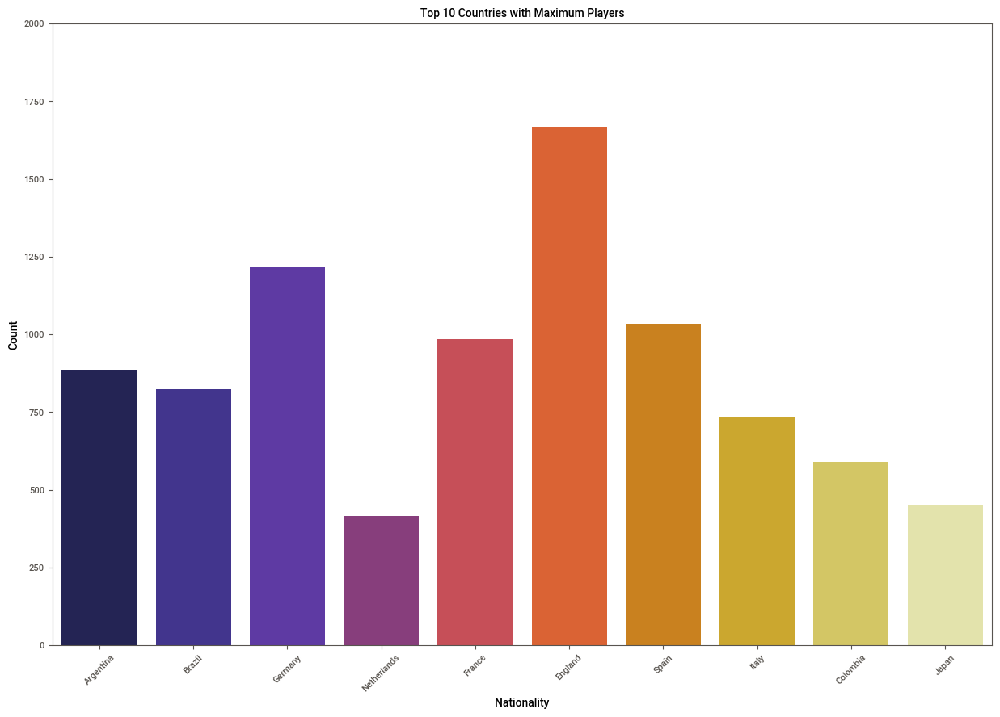

In [118]:
plt.figure(figsize = (15, 10))

top_nationalities = fifa['nationality'].value_counts().nlargest(10)

sns.countplot(x = 'nationality', data = fifa[fifa['nationality'].isin(top_nationalities.index)], palette = 'CMRmap')
plt.xlabel('Nationality')
plt.ylabel('Count')
plt.xticks(rotation = 45)
plt.title('Top 10 Countries with Maximum Players', fontsize = 10)

plt.ylim(0, 2000)  
plt.show()

**Observation:**
- The maximum number of Players in the top 10 are from England and then Germany.

### (b) To plot the distribution of overall rating vs. age of players to find out the age after which the players shows no improvement in performance using FIFA20 Data Set.

#####  Impact of Age on Overall Performance

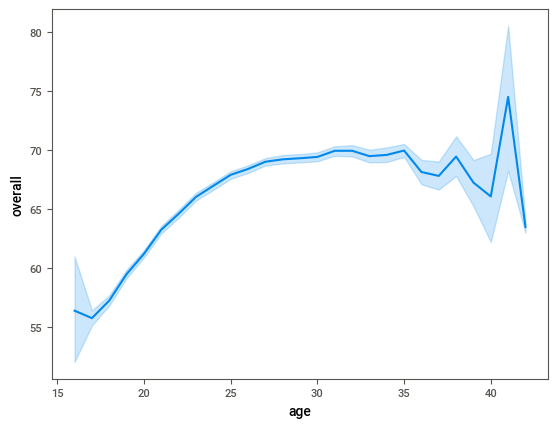

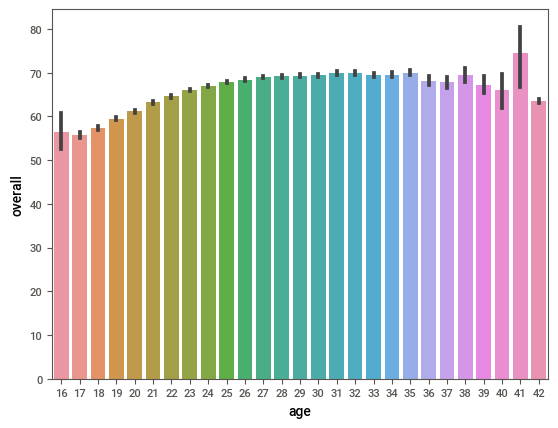

In [119]:
# Line Plot

sns.lineplot(x = 'age', y = 'overall', data = fifa)
plt.show()

# Bar Plot

sns.barplot(x = 'age', y = 'overall', data = fifa)
plt.show()

**Observation:**
- Between Age 18 to 20, the Overall Performance of the players is less.
- The overall Performance of the players are increasing with increase in Age. 
- After the age of nearly 28-32 years, the overall performance of the players is constant.
- Beyond 35 years, there is decrease in performance.

### (c) To find out which type of offensive players tends to get paid the most: the striker, the right-winger or the left-winger using FIFA20 Data Set.

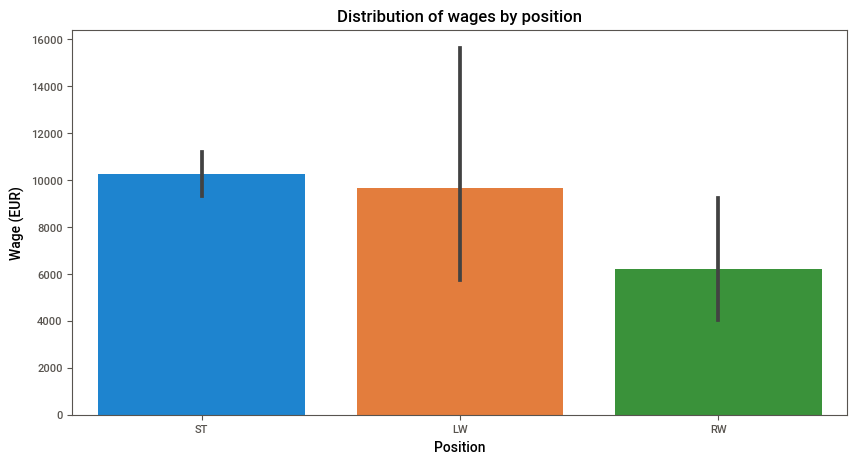

In [120]:
plt.figure(figsize = (10, 5))

# Creating a new column to store the position

forwards_df = fifa[(fifa["player_positions"] == 'LW') | (fifa["player_positions"] == 'RW')| (fifa["player_positions"] == 'ST')]

# Plot the distribution of wages for each position

sns.barplot(x = "player_positions", y = "wage_eur", data = forwards_df)
plt.xlabel("Position")
plt.ylabel("Wage (EUR)")
plt.title("Distribution of wages by position")
plt.show()

**Observation:**
- From the above plot, it is observed that the 'STRIKER PLAYERS' are getting highly paid among all the other player positions.

### SUMMARY OF THE PROJECT

### Model Comparison Report

Using the FIFA20 data set, it was an attempt to cluster similar types of players based on different attributes using K-Means clustering and Hierarchical clustering. It is observed that the scores for both the algorithms were nearly same. But, out of the two, Clustering using K-Means Algorithm performed better.

Clustering (K-Means Algorithm) was done for different number of clusters (2, 3, 4 and 5) and it was observed that Clustering with number of cluster equal to 2, is best for clustering this dataset. The Silhouette Score for cluster number 2 was 0.89.

### Report on Challenges Faced

The challenges we faced during this project are as follows:

1. FIFA20 data set is huge with 18278 records of players (rows) and 104 features (columns). The data preprocessing part was a bit tricky and data needed to be handled differently. 
2. There were numerical and categorical features which needed to be handled separately so the whole data set was split into two categories and then handled accordindly. Later the categorical data were converted to numerical data.
3. Many features were dropped from the data set as they were not as important as others for model building.
4. The data set contained a lot of outliers in some features which were handled separately.
5. There were lots of missing data. Some features were having more that 50% missing values, hence those were dropped. Features with less missing data were imputed accordingly.

### Conclusion

The fifa20 dataset is a challenging dataset. It is an Unsupervised Machine Learning (no target or label in the dataset). Two main takeaways of this project is: clustering the players based on their attributes and finding the most important features to group these players on. 

As it is an unsupervised machine learning, there was a lot of assumptions made but all of our assumptions were backed by facts and numbers. 

As the task was to cluster the players based on their attributes, K-Means Algorithm and Hierarchical Algorithm were used to complete this task.  Out of these two algorithm used, K-Means performed better at cluster number = 2 based on Elbow Method and Silhouette Score.

**Our overall suggestion for clustering this dataset is using K-Means with number of clusters = 2.**